# Week 7<br>Analyzing and Visualizing Large Datasets

Oct 17, 2019

## Housekeeping

- Assignment #5 uploaded today and due in two weeks
- Covers web scraping (last week) and working with large data (today)

## Today: working with big data

**By example:**
- Open Street Map data
- Census data
- NYC taxi cab trips

In [1]:
# Initial imports
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

## The holoViz ecosystem (revisited)

<center>
    <img src=attachment:Screen%20Shot%202019-10-14%20at%208.16.38%20PM.png width=800/>
</center>
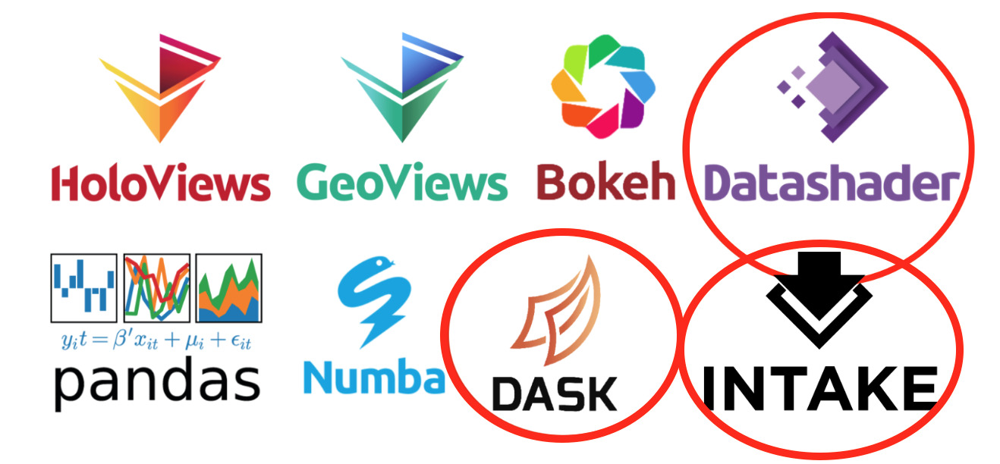

## First up: dask

Out-of-core (larger-than-memory) operations in Python

**Extends the maximum file size from the size of memory to the size of your hard drive**

## The key: lazy evaluation

Dask stores does not evaluate expressions immediately — rather it stores a *task graph* of the necessary calculations.

## Numpy arrays

In [2]:
import numpy as np

# create an array of normally-distributed random numbers
a = np.random.randn(1000)

# multiply this array by a factor
b = a * 4

# find the minimum value
b_min = b.min()
print(b_min)

-10.954442894002666


Dask arrays mirror the numpy array syntax...but don't perform the calculation right away.

In [3]:
import dask.array as da

# create a dask array from the above array
a2 = da.from_array(a, chunks=200)

# multiply this array by a factor
b2 = a2 * 4

# find the minimum value
b2_min = b2.min()
print(b2_min)

dask.array<amin-aggregate, shape=(), dtype=float64, chunksize=(), chunktype=numpy.ndarray>


We need to explicitly call the `compute()` function to evaluate the expression. We get the same result as the non-lazy numpy result.

In [4]:
b2_min.compute()

-10.954442894002666

## Dask dataframes

- Syntax mirrors the Pandas DataFrame object
- Uses the task graph functionality to provides a unified interface to multiple pandas DataFrame objects.

<center>
    <img src=attachment:Screen%20Shot%202019-03-20%20at%202.58.36%20AM.png width=400/>
</center>
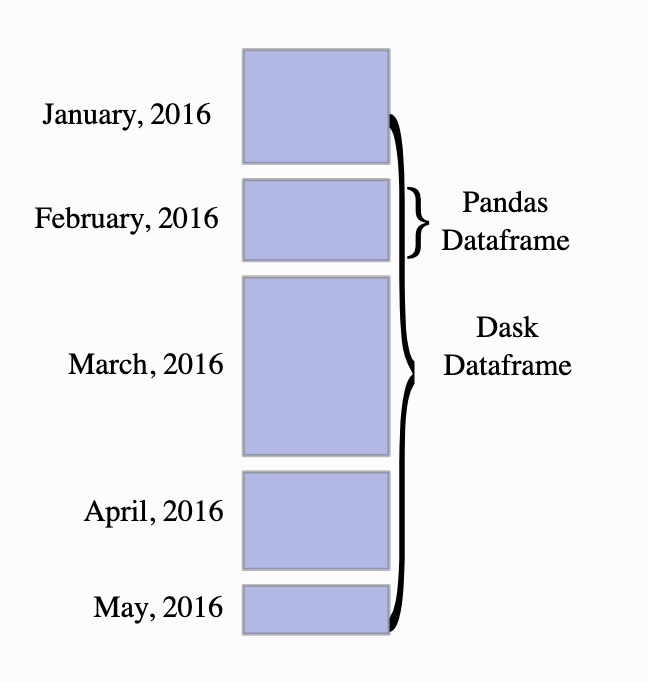

## Enables out-of-core operations

Pandas DataFrames don't need to fit into memory...when evaluating an expression, dask will load the data into memory when necessary.

## Let's try it out:

Loading 1 billion Open Street Map points...

[Source](https://blog.openstreetmap.org/2012/04/01/bulk-gps-point-data/)

## Loading data with intake

- [Intake](https://intake.readthedocs.io/en/latest/) helps make loading data into Python very easy
- Works with the holoViz ecosystem, including dask
- We'll load the OSM data from Amazon s3:
    - http://s3.amazonaws.com/datashader-data/osm-1billion.snappy.parq.zip


## An intake "catalog"

- Metadata that tells Python where and how to download data
- On first download, the data is cached locally to avoid repeated downloaded
- Creates a standard way of sharing datasets 

See [datasets.yml](https://github.com/MUSA-620-Fall-2019/week-7/blob/master/datasets.yml) in this week's repository.

## Load our intake catalog

In [5]:
import intake

In [6]:
datasets = intake.open_catalog("./datasets.yml")

## Which datasets do we have?

In [7]:
list(datasets) 

['nyc_taxi_wide', 'census', 'osm']

In [8]:
osm = datasets.osm()

## 3 "big data" examples today

- 1 billion OSM points: http://s3.amazonaws.com/datashader-data/osm-1billion.parq.zip
- NYC taxi trips: https://s3.amazonaws.com/datashader-data/nyc_taxi_wide.parq 
- 2010 Census data: http://s3.amazonaws.com/datashader-data/census2010.parq.zip

## Example 1: OSM data points

In [10]:
datasets.osm

name: osm
container: dataframe
plugin: ['parquet']
description: 
direct_access: forbid
user_parameters: []
metadata: 
args: 
  urlpath: http://s3.amazonaws.com/datashader-data/osm-1billion.parq.zip
  engine: fastparquet

## Convert the data to a dask array

- This step downloads the data. 
- The first time you run it, you should see a progress bar documenting the download progress. 
- Given the size of the data files (> 1 GB), the download can take several minutes.

In [11]:
df = datasets.osm.to_dask()

In [12]:
df

,x,y
npartitions=119,,
,float32,float32
,...,...
...,...,...
,...,...
,...,...


## Remember:

- The data frame is sub-divided into 119 partitions and only one partition will be loaded into memory at a time.
- No actual data has been loaded from the file yet!

## Let's load the data for the first partition to peek at the head of the file

Only the data necessary to see the head of the file will be loaded.

In [13]:
# we can still get the head of the file quickly
df.head()

,x,y
0,-16274360.0,-17538778.0
1,-16408889.0,-16618700.0
2,-16246231.0,-16106805.0
3,-19098164.0,-14783157.0
4,-17811662.0,-13948767.0


**Note:** Data is latitude/longitude in Web Mercator (EPSG=3857) coordinates

## How about the size of the data frame?

All data partitions must be loaded for this calculation...it will take longer!

In [14]:
# getting the length means all of the data must be loaded though
print("number of rows = ", len(df))

number of rows =  1000050363


### 1 billion rows!

## Let's do some simple calculations

In [15]:
# calculating latitude/longitude
mean_x = df['x'].mean()
mean_y = df['y'].mean()

print(mean_x, mean_y)

dd.Scalar<series-..., dtype=float32> dd.Scalar<series-..., dtype=float32>


In [16]:
# evaluate the expressions
print("mean x = ", mean_x.compute())

mean x =  2731828.833554696


In [17]:
# evaluate the expressions
print("mean y = ", mean_y.compute())

mean y =  5801829.529877755


## Now let's visualize the points...but how?

## Not with matplotlib...

Matplotlib struggles with only hundreds of points

## Enter Datashader

"Turns even the largest data into images, accurately"

Datashader is a library that produces a "rasterized" image of large datasets, such that the visual color mapping is a fair representation of the underlying data.

## Steps

1. Aggregate data onto a pixelized image
1. Map aggregated data to colors to properly represent density of data

<img src=attachment:Screen%20Shot%202019-10-14%20at%209.29.27%20PM.png width=800>
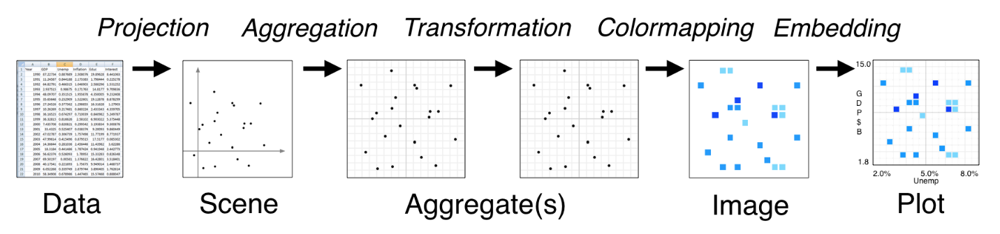

In [18]:
## Setup some formatting options specific to this plot
# Web Mercator bounds
bound = 20026376.39
bounds = dict(x_range = (-bound, bound), y_range = (int(-bound*0.4), int(bound*0.6)))

# widht and height
plot_width = 900
plot_height = int(plot_width*0.5)

In [19]:
# Datashader imports
import datashader as ds
import datashader.transfer_functions as tf

# Color map imports
from datashader.colors import Greys9, viridis, inferno
from colorcet import fire

In [20]:
# setup the canvas
canvas = ds.Canvas(plot_width=plot_width, plot_height=plot_height, **bounds)

# aggregate the points into pixels
agg = canvas.points(df, "x", "y", agg=ds.count())

## The aggregated pixels are stored using *xarray*

In [21]:
agg

<xarray.DataArray (y: 450, x: 900)>
array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int32)
Coordinates:
  * x        (x) float64 -2e+07 -1.996e+07 -1.992e+07 ... 1.996e+07 2e+07
  * y        (y) float64 -7.988e+06 -7.944e+06 ... 1.195e+07 1.199e+07

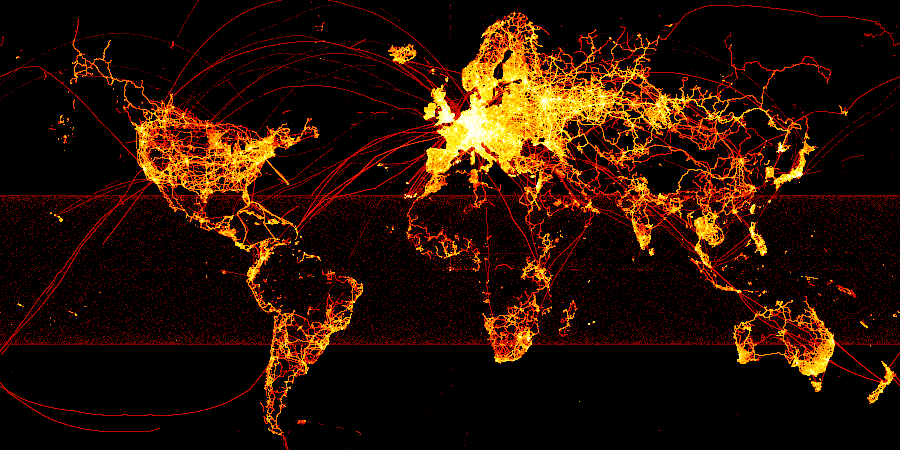

In [22]:
# perform the shade operation
img = tf.shade(agg, cmap=fire)
img = tf.set_background(img, "black")
img

## Remove noise from pixels with low counts

We can leverage xarray's builtin `where()` function to select a subsample of the pixels based on the pixel counts.

In [23]:
selected = agg.where(agg > 15)
selected

<xarray.DataArray (y: 450, x: 900)>
array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])
Coordinates:
  * x        (x) float64 -2e+07 -1.996e+07 -1.992e+07 ... 1.996e+07 2e+07
  * y        (y) float64 -7.988e+06 -7.944e+06 ... 1.195e+07 1.199e+07

### This will mask pixels that do not satisfy the `where` condition  — masked pixels are set to NaN

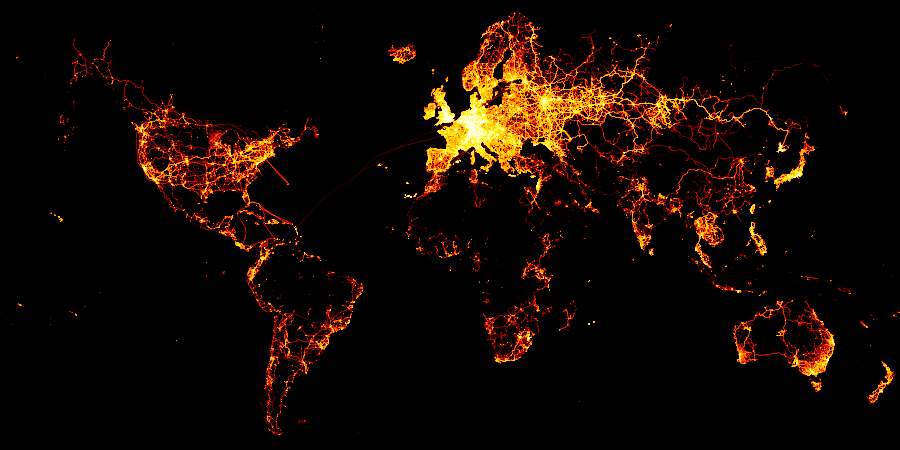

In [24]:
# plot the masked data
tf.set_background(tf.shade(selected, cmap=fire),"black")

## Example 2: revisiting the census dot map

We can use datashader to visualize all 300 million census dots produced as part of the [Cooper Center racial dot map](https://demographics.coopercenter.org/Racial-Dot-Map).

In [25]:
# load the data
# REMEMBER: this will take some time to download the first time
df = datasets.census.to_dask()

In [26]:
df

,easting,northing,race
npartitions=36,,,
,float32,float32,category[unknown]
,...,...,...
...,...,...,...
,...,...,...
,...,...,...


In [27]:
df.head()

,easting,northing,race
0,-12418767.0,3697425.00,h
1,-12418512.0,3697143.50,h
2,-12418245.0,3697584.50,h
3,-12417703.0,3697636.75,w
4,-12418120.0,3697129.25,h


In [28]:
print("number of rows =", len(df))

number of rows = 306675004


### roughly 300 million rows: 1 for each person in the U.S. population

### Set up bounds for major cities and USA

**Important: datashader requires Web Mercator coordinates and has a utility function to convert from latitude/longitude**

In [33]:
from datashader.utils import lnglat_to_meters

# Sensible lat/lng coordinates for U.S. cities
USA           = ((-124.72,  -66.95), (23.55, 50.06))
Chicago       = (( -88.29,  -87.30), (41.57, 42.00))
NewYorkCity   = (( -74.39,  -73.44), (40.51, 40.91))
LosAngeles    = ((-118.53, -117.81), (33.63, 33.96))
Houston       = (( -96.05,  -94.68), (29.45, 30.11))
Austin        = (( -97.91,  -97.52), (30.17, 30.37))
NewOrleans    = (( -90.37,  -89.89), (29.82, 30.05))
Atlanta       = (( -84.88,  -84.04), (33.45, 33.84))
Philly        = (( -75.28,  -74.96), (39.86, 40.14))


x_range, y_range = [list(r) for r in lnglat_to_meters(USA[0], USA[1])]
plot_width  = int(900)
plot_height = int(plot_width*7.0/12)

## First, visualize the population density

## How about a linear color scale?

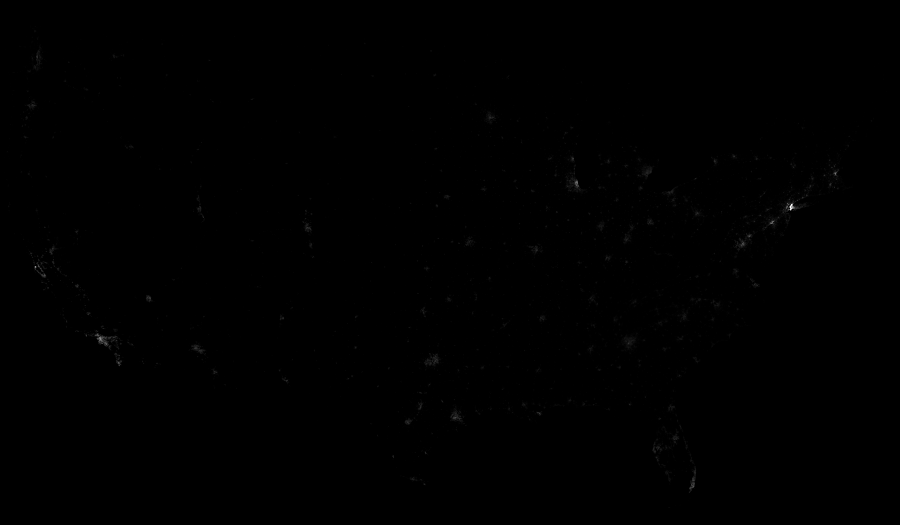

In [34]:
# X and Y bounds for the USA
x_range, y_range = lnglat_to_meters(USA[0], USA[1])

# Setup the bounds
cvs = ds.Canvas(plot_width, plot_height, x_range=x_range, y_range=y_range)

# Aggregate the x/y points
agg = cvs.points(df, "easting", "northing")

# Shade
img = tf.shade(agg, cmap=Greys9, how="linear")

# Set the background
tf.set_background(img, "black")

## Okay, what about a log scale?

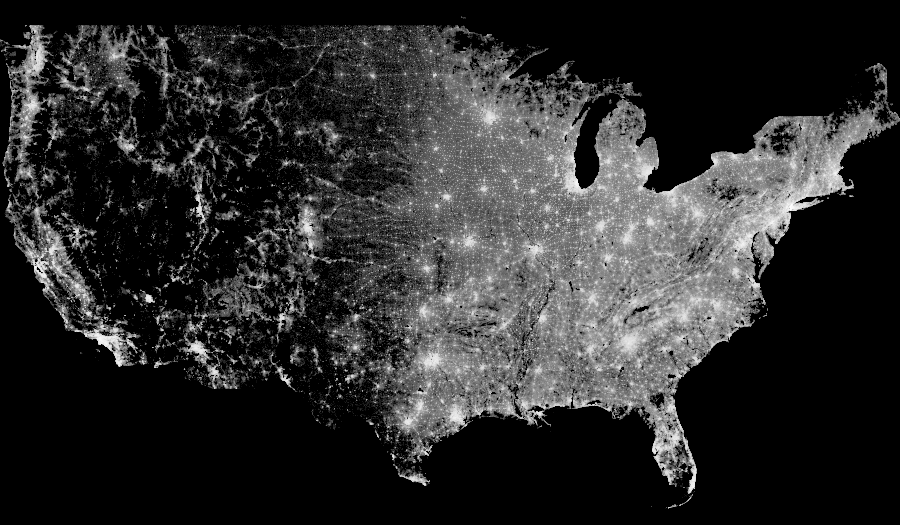

In [35]:
img = tf.shade(agg, cmap=Greys9, how='log')
tf.set_background(img, 'black')

## Let's use a perceptually uniform color map

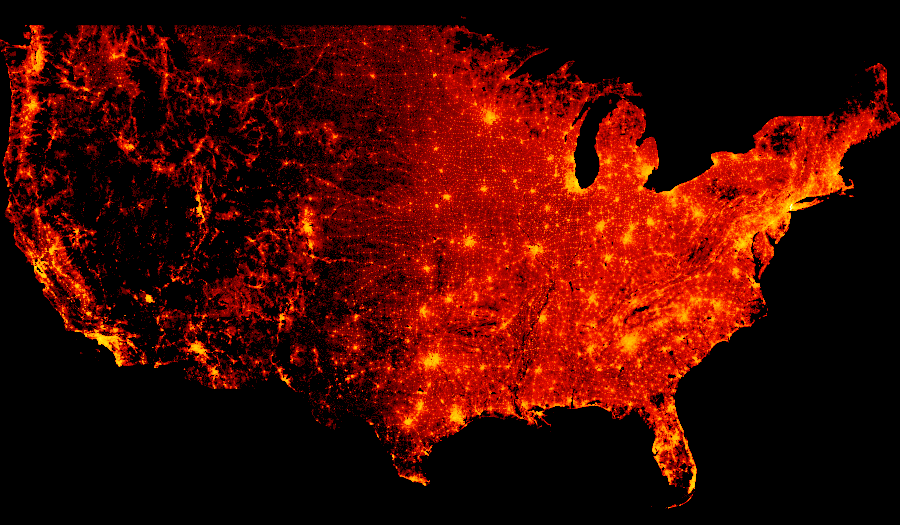

In [36]:
img = tf.shade(agg, cmap=fire, how='log')
tf.set_background(img, 'black')

## The best option: using the equal histogram method for shading

- This is the default shading option for color mapping in datashader
- A common [image processing](https://en.wikipedia.org/wiki/Histogram_equalization) technique for improving contrast and equalizing pixel values across images

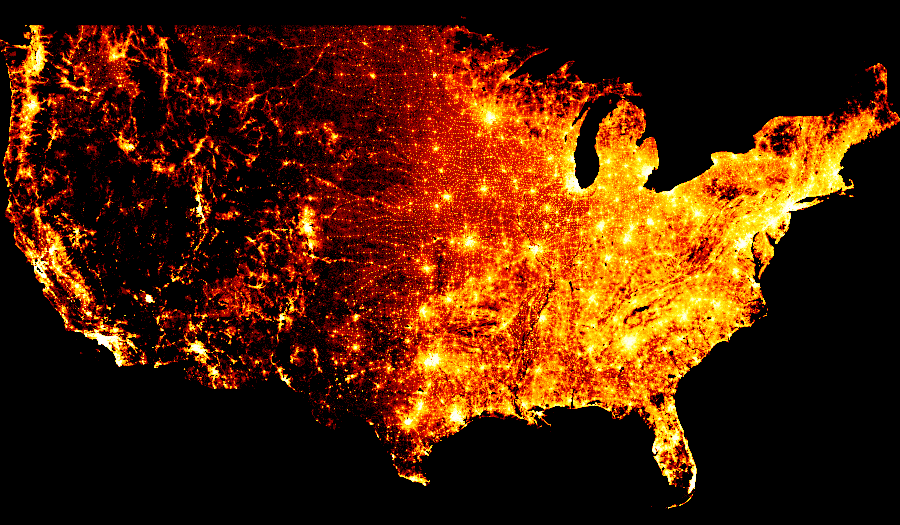

In [37]:
img = tf.shade(agg, cmap=fire, how='eq_hist')
tf.set_background(img, 'black')

## How about viridis?

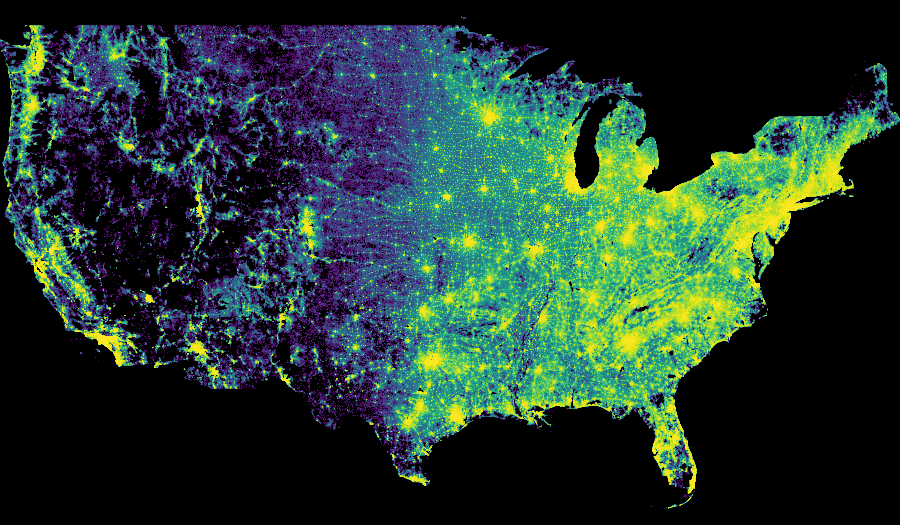

In [38]:
img = tf.shade(agg, cmap=viridis, how='eq_hist')
img = tf.set_background(img, 'black')
img

## How to save?

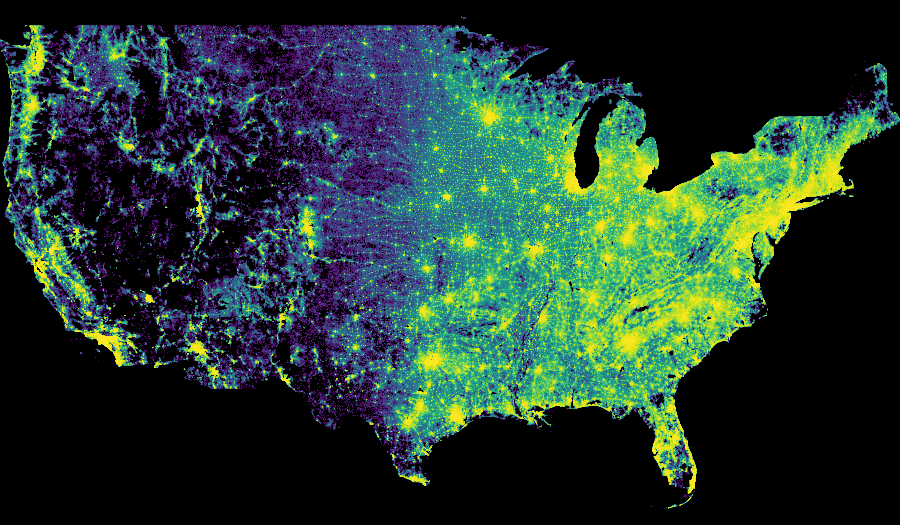

In [39]:
from datashader.utils import export_image
export_image(img, 'usa_census_viridis')

## Next, let's visualize race

Datashader can plot use different colors for different categories of data.

In [40]:
df.head()

,easting,northing,race
0,-12418767.0,3697425.00,h
1,-12418512.0,3697143.50,h
2,-12418245.0,3697584.50,h
3,-12417703.0,3697636.75,w
4,-12418120.0,3697129.25,h


In [41]:
color_key = {"w": "aqua", "b": "lime", "a": "red", "h": "fuchsia", "o": "yellow"}


def create_image(longitude_range, latitude_range, w=plot_width, h=plot_height):
    """
    A function for plotting the Census data, coloring pixel by race values.
    """
    # x and y range from lng/lat ranges
    x_range, y_range = lnglat_to_meters(longitude_range, latitude_range)

    # setup the canvas
    cvs = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)

    # aggregate, but this time count the "race" category
    # NEW: specify the aggregation method to count the "race" values in each pixel
    agg = cvs.points(df, "easting", "northing", agg=ds.count_cat("race"))

    # shade, using our color key
    img = tf.shade(agg, color_key=color_key, how="eq_hist")

    return tf.set_background(img, "black")

## Let's visualize all 300 million points

Color pixel values according to the demographics data in each pixel.

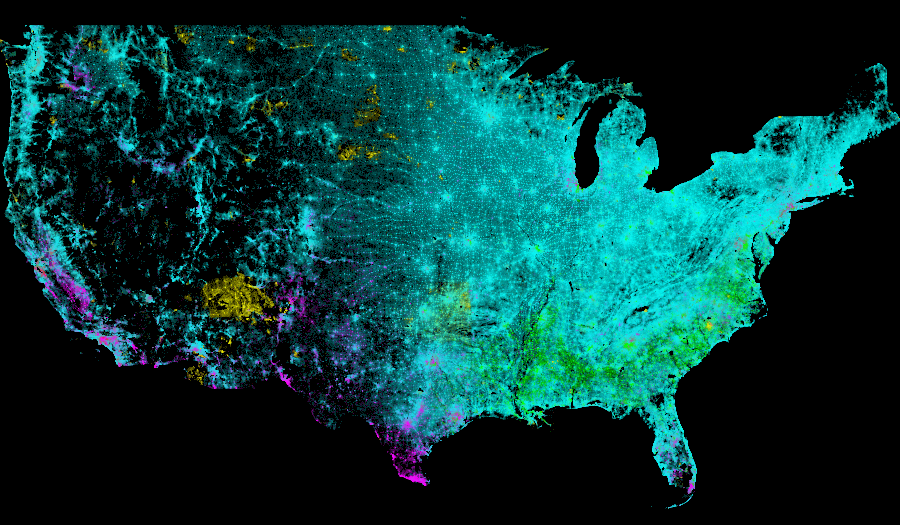

In [42]:
create_image(USA[0], USA[1])

### Remember: color scheme

- White: aqua
- Black/African American: lime
- Asian: red
- Hispanic: fuchsia
- Other: yellow

## Let's zoom in on Philadelphia...

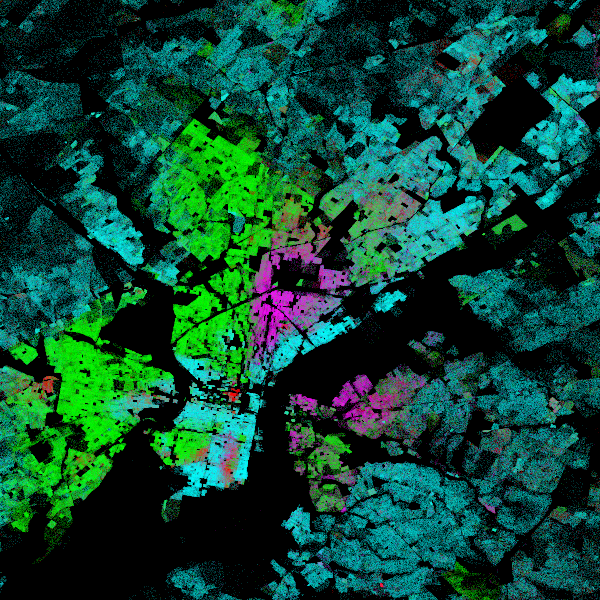

In [43]:
create_image(Philly[0], Philly[1], w=600, h=600)

## What about other cities?

Exercise: use the bounding boxes provided earlier to explore racial patterns across various major cities

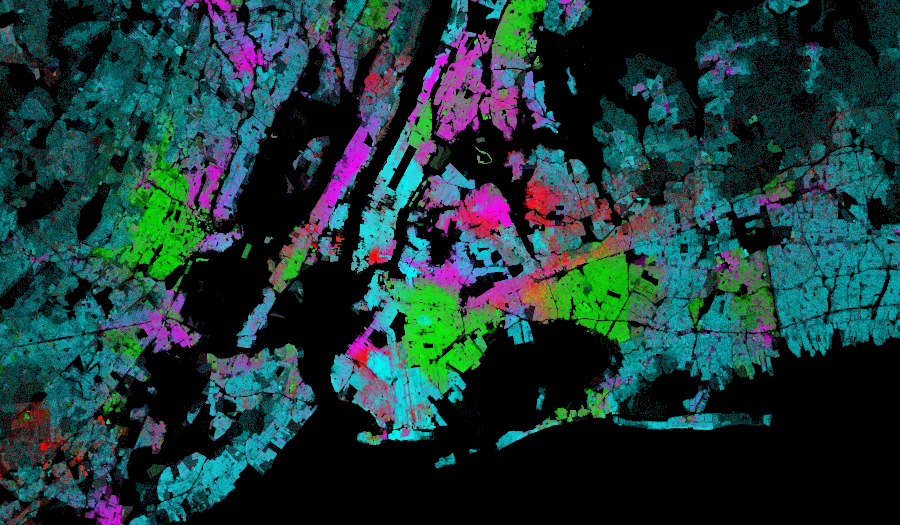

In [44]:
create_image(NewYorkCity[0], NewYorkCity[1])

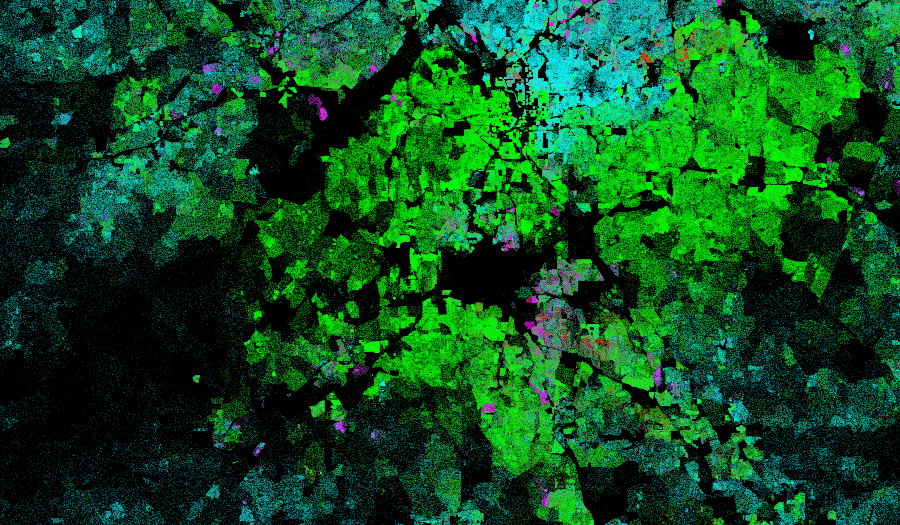

In [45]:
create_image(Atlanta[0], Atlanta[1])

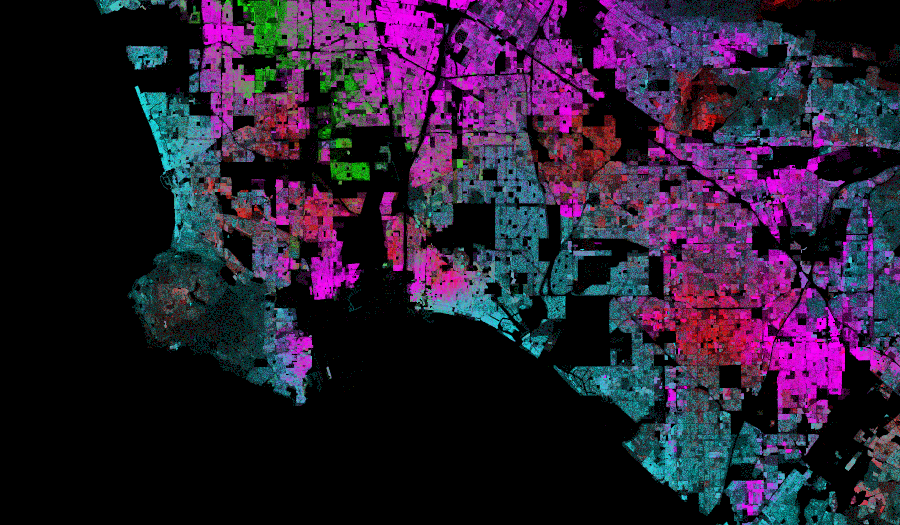

In [46]:
create_image(LosAngeles[0], LosAngeles[1])

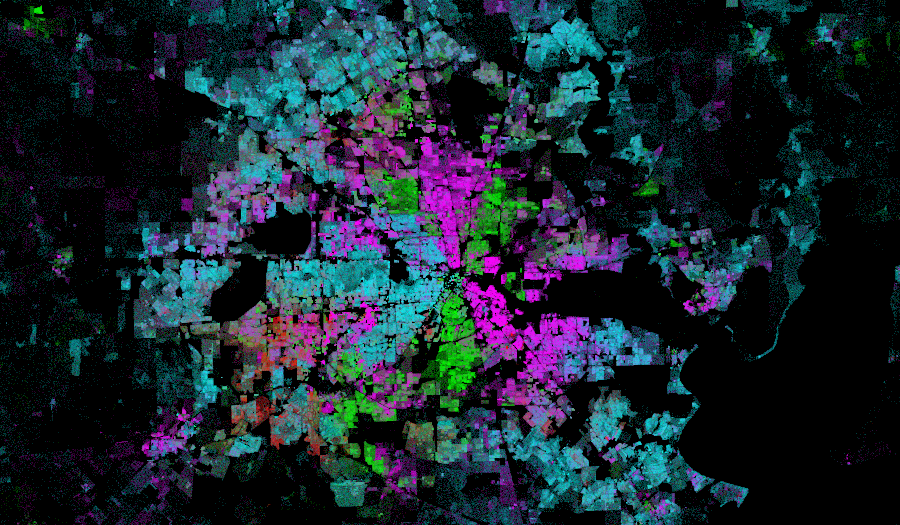

In [47]:
create_image(Houston[0], Houston[1])

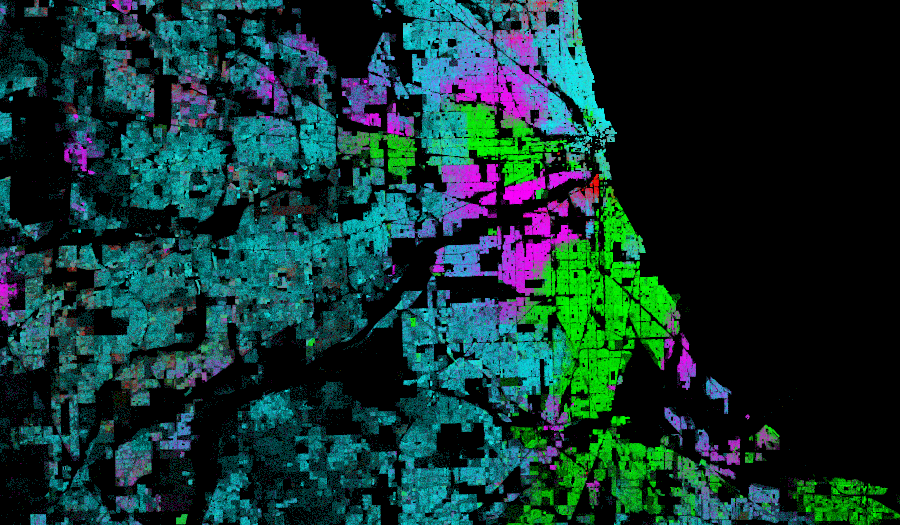

In [48]:
create_image(Chicago[0], Chicago[1])

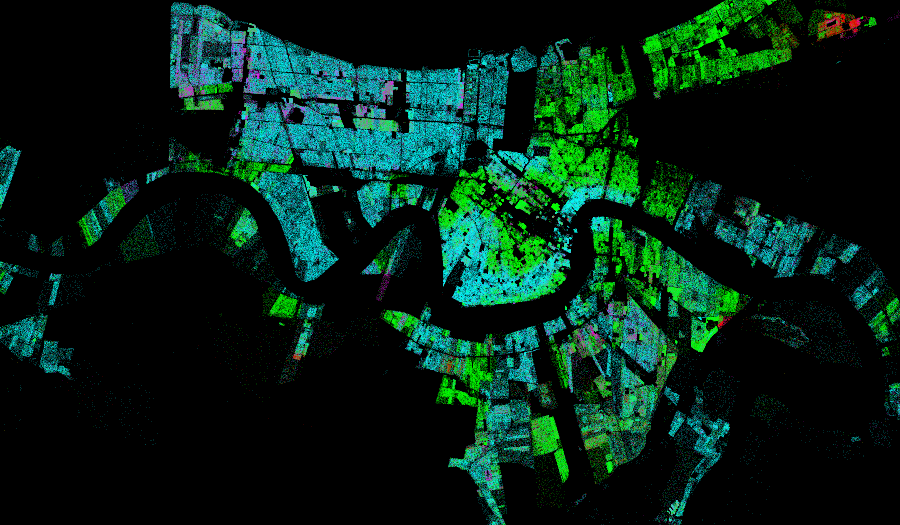

In [49]:
create_image(NewOrleans[0], NewOrleans[1])

## Can we learn more than just population density and race?

We can use *xarray* to slice the array of aggregated pixel values to examine specific aspects of the data.

## Question: Where do African Americans live?

Use the `sel()` function of the *xarray* array

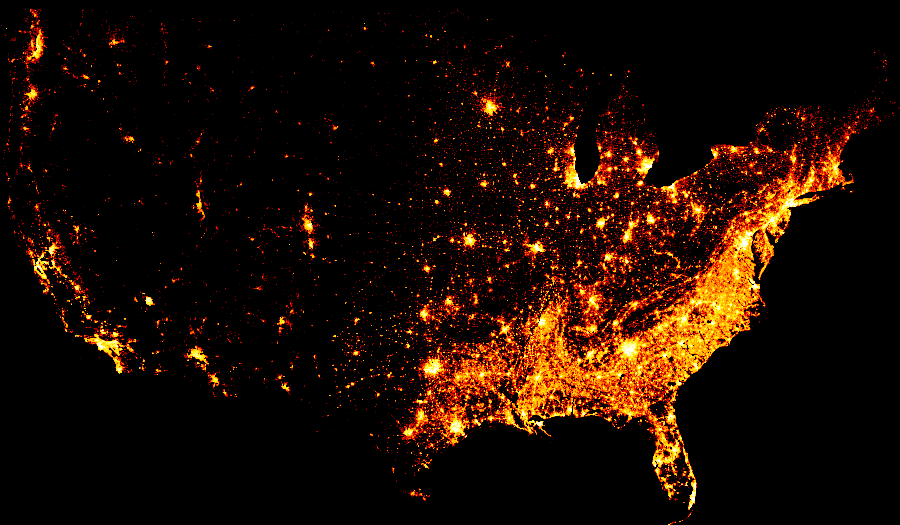

In [50]:
# setup canvas
cvs = ds.Canvas(plot_width=plot_width, plot_height=plot_height)

# aggregate and count race category
aggc = cvs.points(df, "easting", "northing", agg=ds.count_cat("race"))

# NEW: select only African Americans
agg_b = aggc.sel(race="b")

# and plot
img = tf.shade(agg_b, cmap=fire, how="eq_hist")
img = tf.set_background(img, "black")

img

## Question: How to identify diverse areas?

Select pixels where each race has a non-zero count

In [51]:
# Find the pixels that have a non-zero count of each race
diverse_selection = (aggc.sel(race=['w', 'b', 'a', 'h']) > 0).all(dim='race')

diverse_selection

<xarray.DataArray (northing: 525, easting: 900)>
array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])
Coordinates:
  * easting   (easting) float64 -1.388e+07 -1.387e+07 ... -7.464e+06 -7.457e+06
  * northing  (northing) float64 2.822e+06 2.828e+06 ... 6.326e+06 6.333e+06

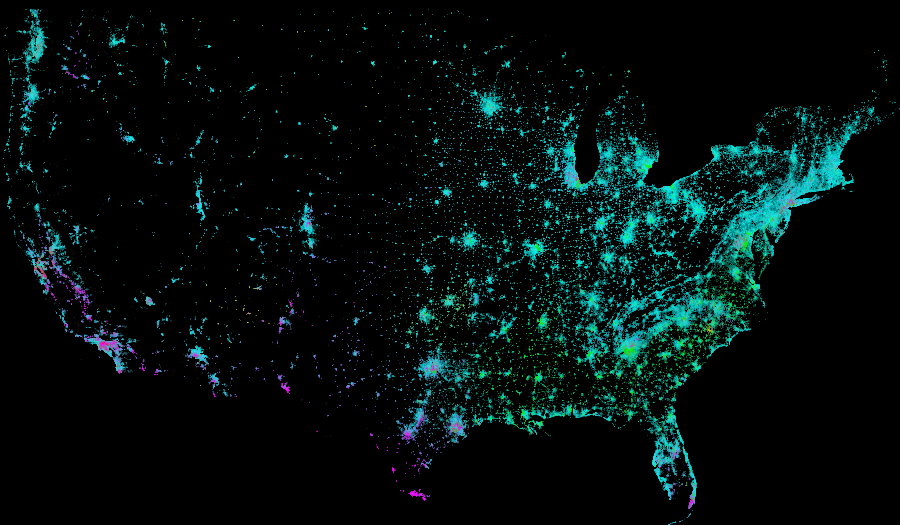

In [52]:
# Select the pixel values where our diverse selection criteria is True
agg2 = aggc.where(diverse_selection).fillna(0)

# and shade using our color key
img = tf.shade(agg2, color_key=color_key, how='eq_hist')
img = tf.set_background(img,"black")

img 

## Question: Where are there more African Americans than whites?

In [53]:
# Select where the "b" race dimension is greater than the "w" race dimension
selection = aggc.sel(race='b') > aggc.sel(race='w') 

selection

<xarray.DataArray (northing: 525, easting: 900)>
array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])
Coordinates:
  * easting   (easting) float64 -1.388e+07 -1.387e+07 ... -7.464e+06 -7.457e+06
  * northing  (northing) float64 2.822e+06 2.828e+06 ... 6.326e+06 6.333e+06

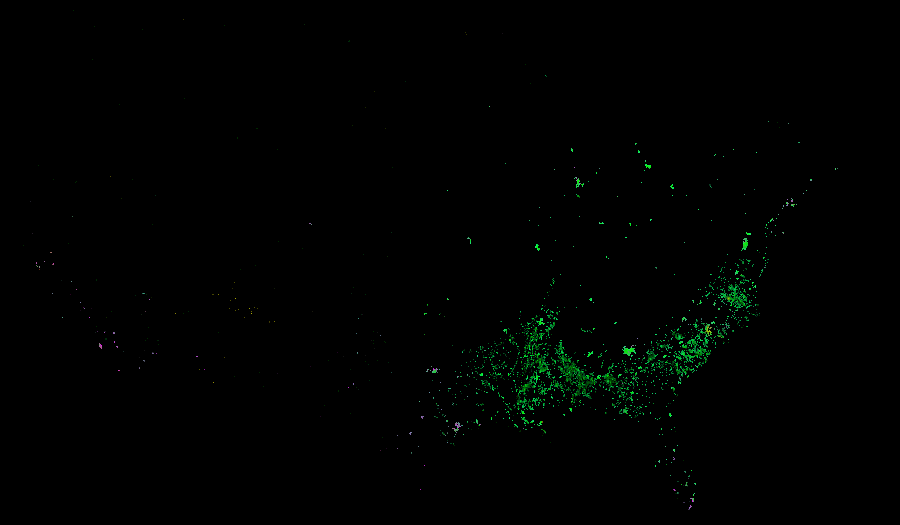

In [54]:
# Select based on the selection criteria
agg2 = aggc.where(selection).fillna(0)

img = tf.shade(agg2, color_key=color_key, how='eq_hist')
img = tf.set_background(img,"black")

img

## Now let's make it interactive!


**Let's use HoloViews**

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
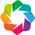

In [55]:
import holoviews as hv
import geoviews as gv
from holoviews.operation.datashader import datashade
hv.extension("bokeh")

## Side note: persisting dask arrays in memory

To speed up interactive calculations, you can "persist" a dask array in memory (load the data fully into memory). You should have at least 16 GB of memory to avoid memory errors, though!

If not persisted, the data will be loaded on demand to avoid memory issues, which will slow the interactive nature of the plots down slightly.

In [56]:
# UNCOMMENT THIS LINE IF YOU HAVE AT LEADT 16 GB OF MEMORY
df = df.persist()

In [57]:
# a holoview Points data set
points = hv.Points(df, kdims=['easting', 'northing'])

# shaded 
census = datashade(points, cmap=fire).opts(width=700, height=400)

# background tile
bg = gv.tile_sources.CartoDark

bg * census

:DynamicMap   []
   :Overlay
      .WMTS.I :WMTS   [Longitude,Latitude]
      .RGB.I  :RGB   [easting,northing]   (R,G,B,A)

## We can visualize color-coded race interactively as well

In [58]:
# specify race as part of "vdims" 
points = hv.Points(df, kdims=['easting', 'northing'], vdims=['race'])

# similar syntax for color key and aggregator
race = datashade(points, color_key=color_key, aggregator=ds.count_cat('race'))

# combine images
img = (bg * race)
img.opts(width=800, height=600)

:DynamicMap   []
   :Overlay
      .WMTS.I :WMTS   [Longitude,Latitude]
      .RGB.I  :RGB   [easting,northing]   (R,G,B,A)

## Use case: exploring gerrymandering

We can easily overlay Congressional districts on our map...

### Load the shape file into GeoViews:

In [59]:
# Use GeoViews to load the shapefile of Congressional districts
districts = gv.Shape.from_shapefile('./data/cb_2015_us_cd114_5m')

# Style the district polygons
districts = districts.opts(line_color='white')

In [60]:
# Combine the background, race map, and districts into a single map
img = bg * race * districts

# Set the width/height
img.opts(width=700, height=500)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [easting,northing]   (R,G,B,A)
      .Polygons.I :Polygons   [Longitude,Latitude]

## Example 3: NYC taxi data

12 million taxi trips from 2015...

In [61]:
# Load from our intake catalog
# Remember: this will take some time to download the first time!
ddf = datasets.nyc_taxi_wide.to_dask()

In [62]:
print('%s Rows' % len(ddf))
print('Columns:', list(ddf.columns))

11842094 Rows
Columns: ['tpep_pickup_datetime', 'tpep_dropoff_datetime', 'passenger_count', 'trip_distance', 'pickup_x', 'pickup_y', 'dropoff_x', 'dropoff_y', 'fare_amount', 'tip_amount', 'dropoff_hour', 'pickup_hour']


In [63]:
ddf.head()

,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,pickup_x,pickup_y,dropoff_x,dropoff_y,fare_amount,tip_amount,dropoff_hour,pickup_hour
0,2015-01-15 19:05:39,2015-01-15 19:23:42,1,1.59,-8236963.0,4975552.5,-8234835.5,4975627.0,12.0,3.25,19,19
1,2015-01-10 20:33:38,2015-01-10 20:53:28,1,3.30,-8237826.0,4971752.5,-8237020.5,4976875.0,14.5,2.00,20,20
2,2015-01-10 20:33:38,2015-01-10 20:43:41,1,1.80,-8233561.5,4983296.5,-8232279.0,4986477.0,9.5,0.00,20,20
3,2015-01-10 20:33:39,2015-01-10 20:35:31,1,0.50,-8238654.0,4970221.0,-8238124.0,4971127.0,3.5,0.00,20,20
4,2015-01-10 20:33:39,2015-01-10 20:52:58,1,3.00,-8234433.5,4977363.0,-8238107.5,4974457.0,15.0,0.00,20,20


## Exploring the taxi pick ups...

In [64]:
# Create a Holoviews data set of pickups 
points = hv.Points(ddf, kdims=['pickup_x', 'pickup_y'])

In [65]:
# Create the interactive map
datashade(points, cmap=fire).opts(width=800, height=600, bgcolor="black")

:DynamicMap   []
   :RGB   [pickup_x,pickup_y]   (R,G,B,A)

## Comparing pickups and dropoffs

- Pixels with more pickups: red
- Pixels with more dropoffs: blue

In [66]:
NYC = [(-8242000,-8210000), (4965000,4990000)]
plot_width  = int(750)
plot_height = int(plot_width//1.2)

def merged_images(x_range, y_range, w=plot_width, h=plot_height, how='eq_hist'):
    
    # the canvas
    cvs = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)
    
    # pick ups
    picks = cvs.points(ddf, 'pickup_x',  'pickup_y',  ds.count('passenger_count'))
    
    # drop offs
    drops = cvs.points(ddf, 'dropoff_x', 'dropoff_y', ds.count('passenger_count'))
    
    # rename to same names
    drops = drops.rename({'dropoff_x': 'x', 'dropoff_y': 'y'})
    picks = picks.rename({'pickup_x': 'x', 'pickup_y': 'y'})
    
    # NEW: shade pixels there are more drop offs than pick ups
    # These are colored blue
    more_drops = tf.shade(drops.where(drops > picks), cmap=["darkblue", 'cornflowerblue'], how=how)
    
    # NEW: shade pixels where there are more pick ups than drop offs
    # These are colored red
    more_picks = tf.shade(picks.where(picks > drops), cmap=["darkred", 'orangered'], how=how)
    
    # NEW: add the images together!
    img = tf.stack(more_picks, more_drops)
    
    return tf.set_background(tf.dynspread(img, threshold=0.3, max_px=4), 'black')

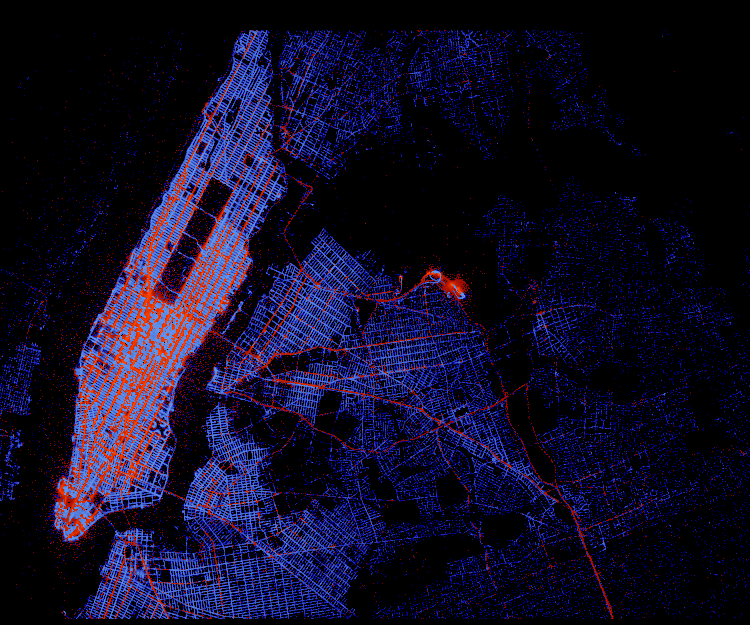

In [67]:
merged_images(NYC[0], NYC[1])

**Takeaway:** pickups occur more often on major roads, and dropoffs on smaller roads

## Let's generate a time-lapse GIF of drop-offs over time

Powerful tool for visualizing trends over time

## Define some functions...

**Important:** We can convert our datashaded images to the format of the Python Imaging Library to visualize 

In [68]:
def create_image(df, x_range, y_range, w=plot_width, h=plot_height, cmap=fire):
    
    # create the canvas
    cvs = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)
    
    # plot dropoff positions, coutning number of passengers
    agg = cvs.points(df, 'dropoff_x', 'dropoff_y',  ds.count('passenger_count'))
    
    # shade
    img = tf.shade(agg, cmap=cmap, how='eq_hist')
    
    # return an PIL image
    return tf.set_background(img, "black").to_pil()

In [69]:
def convert_to_12hour(hr24):
    """
    Convert from 24 hr to 12 hr.
    """
    from datetime import datetime
    d = datetime.strptime(str(hr24), "%H")
    return d.strftime("%I %p")

In [70]:
def plot_dropoffs_by_hour(fig, data_all_hours, hour, x_range, y_range):
    """
    Plot the dropoffs for particular hour
    """
    # trim to the specific hour
    df_this_hour = data_all_hours.loc[data_all_hours["dropoff_hour"] == hour]

    # create the datashaded image
    img = create_image(df_this_hour, x_range, y_range)

    # plot the image on a matplotlib axes
    plt.clf()
    ax = fig.gca()
    ax.imshow(img, extent=[x_range[0], x_range[1], y_range[0], y_range[1]])
    ax.set_axis_off()

    # add a text label for the hour
    ax.text(
        0.05,
        0.9,
        convert_to_12hour(hour),
        color="white",
        fontsize=40,
        ha="left",
        transform=ax.transAxes,
    )

    # draw the figure and return the image
    fig.canvas.draw()
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype="uint8")
    image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    return image

## Use `imageio` to convert to save images as a GIF

In [71]:
import imageio

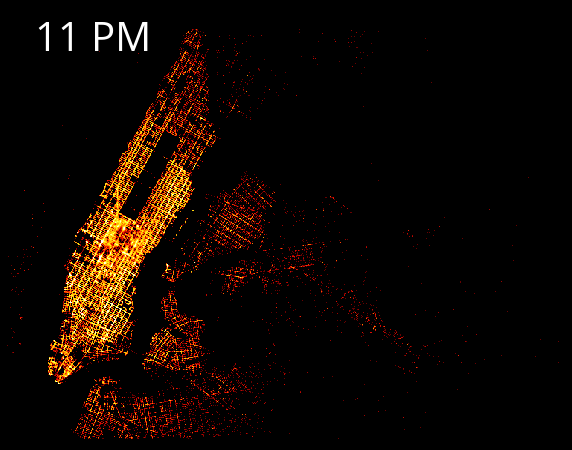

In [72]:
# create a figure
fig, ax = plt.subplots(figsize=(10,10), facecolor='black')

# Create an image for each hour
imgs = []
for hour in range(24):
    img = plot_dropoffs_by_hour(fig, ddf, hour, x_range=NYC[0], y_range=NYC[1])
    imgs.append(img)
    
# Combing the images for each hour into a single GIF
imageio.mimsave('dropoffs.gif', imgs, fps=1);

## Side note: Analyzing hourly and weekly trends for taxis using holoviews

- We'll load taxi data from 2016 that includes the number of pickups per hour.
- Visualize weekly and hourly trends using a *radial heatmap*

In [73]:
df = pd.read_csv('./data/nyc_taxi_2016_by_hour.csv.gz', parse_dates=['Pickup_date'])

In [74]:
df.head()

,Pickup_date,Pickup_Count
0,2016-01-01 00:00:00,19865
1,2016-01-01 01:00:00,24376
2,2016-01-01 02:00:00,24177
3,2016-01-01 03:00:00,21538
4,2016-01-01 04:00:00,15665


## Add date-related columns with `strftime`

We can use the `strftime()` function of a datetime Series to extract specific aspects of a date object. In this case, we are interested in:

- Day of Week (Monday, Tuesday, etc) and hour of day
- Week of Year

To find the specific string notation for these, use: http://strftime.org

In [76]:
# create relevant time columns
df["Day & Hour"] = df["Pickup_date"].dt.strftime("%A %H:00")
df["Week of Year"] = df["Pickup_date"].dt.strftime("Week %W")
df["Date"] = df["Pickup_date"].dt.strftime("%Y-%m-%d")

In [77]:
df

,Pickup_date,Pickup_Count,Day & Hour,Week of Year,Date
0,2016-01-01 00:00:00,19865,Friday 00:00,Week 00,2016-01-01
1,2016-01-01 01:00:00,24376,Friday 01:00,Week 00,2016-01-01
2,2016-01-01 02:00:00,24177,Friday 02:00,Week 00,2016-01-01
3,2016-01-01 03:00:00,21538,Friday 03:00,Week 00,2016-01-01
4,2016-01-01 04:00:00,15665,Friday 04:00,Week 00,2016-01-01
...,...,...,...,...,...
8779,2016-12-31 19:00:00,34197,Saturday 19:00,Week 52,2016-12-31
8780,2016-12-31 20:00:00,39768,Saturday 20:00,Week 52,2016-12-31
8781,2016-12-31 21:00:00,41832,Saturday 21:00,Week 52,2016-12-31
8782,2016-12-31 22:00:00,40328,Saturday 22:00,Week 52,2016-12-31


## Let's plot a radial heatmap

The binning dimensions of the heat map will be:

- Day of Week and Hour of Day
- Week of Year

A radial heatmap can be read similar to tree rings:

- The center of the heatmap will represent the first week of the year, while the outer edge is the last week of the year
- Rotating clockwise along a specific ring tells you the day/hour.

In [78]:
cols = ["Day & Hour", "Week of Year", "Pickup_Count", "Date"]
heatmap = hv.HeatMap(df[cols], kdims=["Day & Hour", "Week of Year"], vdims=["Pickup_Count", "Date"])

In [79]:
heatmap.opts(
    radial=True,
    height=600,
    width=600,
    yticks=None,
    xmarks=7,
    ymarks=3,
    start_angle=np.pi * 19 / 14,
    xticks=(
        "Friday",
        "Saturday",
        "Sunday",
        "Monday",
        "Tuesday",
        "Wednesday",
        "Thursday",
    ),
    tools=["hover"],
)

:HeatMap   [Day & Hour,Week of Year]   (Pickup_Count,Date)

## Trends

- Taxi pickup counts are high between 7-9am and 5-10pm during weekdays which business hours as expected. In contrast, during weekends, there is not much going on until 11am.
- Friday and Saterday nights clearly stand out with the highest pickup densities as expected.
- Public holidays can be easily identified. For example, taxi pickup counts are comparetively low around Christmas and Thanksgiving.
- Weather phenomena also influence taxi service. There is a very dark blue stripe at the beginning of the year starting at Saterday 23rd and lasting until Sunday 24th. Interestingly, there was one of the biggest blizzards in the history of NYC.

## Exercise: datashading OpenDataPhilly data (time permitting)

You can choose your own data set, but it must have latitude/longitude and should be reasonably large to work best. Some good choices include: 

- [311 data](https://www.opendataphilly.org/dataset/311-service-and-information-requests)
- [Property assessments](https://www.opendataphilly.org/dataset/opa-property-assessments)
- [Crime incidents](https://www.opendataphilly.org/dataset/crime-incidents)
- [Parking violations](https://www.opendataphilly.org/dataset/parking-violations)

**Remember: you will need to convert latitude/longitude to Web Mercator (epsg=3857) to work with datashader.**

### Load a data frame directly with dask

In [80]:
import dask.dataframe as dd

In [81]:
df = dd.read_csv("./data/parking_violations.csv", assume_missing=True)

In [82]:
df.head()

,violation_desc,anon_ticket_number,state,anon_plate_id,division,location,issue_datetime,fine,issuing_agency,lat,lon,gps,zip_code
0,EXPIRED INSPECTION,1777797.0,PA,878255.0,1.0,212 N 12TH ST,2013-08-22 12:36:00,41.0,PPA,39.956252,-75.158937,False,19107.0
1,METER EXPIRED CC,1777798.0,PA,878255.0,1.0,900 RACE ST,2013-09-23 21:52:00,36.0,PPA,39.955233,-75.154730,False,19107.0
2,METER EXPIRED,1777799.0,NJ,328900.0,1.0,5448 GERMANTOWN AVE,2013-11-23 12:25:00,26.0,PPA,40.034175,-75.172386,False,19144.0
3,METER EXPIRED CC,1777800.0,NJ,244961.0,NaN,400 SPRINGGA,2013-01-18 22:56:00,36.0,PPA,NaN,NaN,NaN,NaN
4,METER EXPIRED CC,1777801.0,PA,665834.0,1.0,1000 FILBERT ST,2013-05-17 12:11:00,36.0,PPA,39.952661,-75.157291,False,19107.0


### Remove rows with missing geometries

In [147]:
df = df.loc[df['lat'].notnull()]

### Convert lat/lng to Web Mercator coordinates (x, y)

In [148]:
from datashader.utils import lnglat_to_meters

In [151]:
df['x'], df['y'] = lnglat_to_meters(df['lon'], df['lat'])

In [157]:
df.head()

,violation_desc,anon_ticket_number,state,anon_plate_id,division,location,issue_datetime,fine,issuing_agency,lat,lon,gps,zip_code,x,y
0,EXPIRED INSPECTION,1777797.0,PA,878255.0,1.0,212 N 12TH ST,2013-08-22 12:36:00,41.0,PPA,39.956252,-75.158937,False,19107.0,-8.366655e+06,4.859587e+06
1,METER EXPIRED CC,1777798.0,PA,878255.0,1.0,900 RACE ST,2013-09-23 21:52:00,36.0,PPA,39.955233,-75.154730,False,19107.0,-8.366186e+06,4.859439e+06
2,METER EXPIRED,1777799.0,NJ,328900.0,1.0,5448 GERMANTOWN AVE,2013-11-23 12:25:00,26.0,PPA,40.034175,-75.172386,False,19144.0,-8.368152e+06,4.870910e+06
4,METER EXPIRED CC,1777801.0,PA,665834.0,1.0,1000 FILBERT ST,2013-05-17 12:11:00,36.0,PPA,39.952661,-75.157291,False,19107.0,-8.366471e+06,4.859066e+06
5,METER EXPIRED CC,1777802.0,PA,847624.0,NaN,1400 CALLOWHILL ST,2013-10-15 12:10:00,36.0,PPA,39.959713,-75.162902,False,19130.0,-8.367096e+06,4.860090e+06


### Get the x/ range for Philadelphia

In [158]:
Philly[0]

(-75.28, -74.96)

In [159]:
Philly[1]

(39.86, 40.14)

In [160]:
x_range, y_range = lnglat_to_meters(Philly[0], Philly[1])

### Datashade the density of parking violations

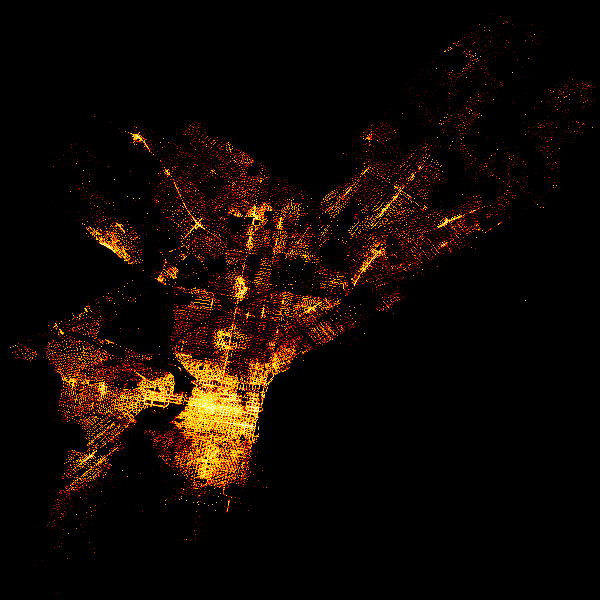

In [161]:
# Create the canvas
cvs = ds.Canvas(plot_width=600, plot_height=600, x_range=x_range, y_range=y_range)

# Aggregate the points
agg = cvs.points(df, "x", "y", agg=ds.count())

# Shade the aggregated pixels
img = tf.shade(agg, cmap=fire, how="eq_hist")

# Set the background of the image
img = tf.set_background(img, "black")

# Show!
img

### An interactive map of the the parking violations

In [162]:
# a holoview Points data set
points = hv.Points(df, kdims=['x', 'y'])

# shaded 
violations = datashade(points, cmap=fire).opts(width=700, height=400)

# background tile
bg = gv.tile_sources.CartoDark

bg * violations

:DynamicMap   []
   :Overlay
      .WMTS.I :WMTS   [Longitude,Latitude]
      .RGB.I  :RGB   [x,y]   (R,G,B,A)